# Margin Call Likelihood Analysis

In [1]:
import pandas as pd
import numpy as np
from string import digits
import math
from tqdm import tqdm
import yaml
from functools import reduce

import helpers as hlp

from plotly.offline import init_notebook_mode, iplot
import plotly_utilities as pu

# Allow plotly to operate within the notebook
init_notebook_mode()

%load_ext autoreload
%autoreload 2

### Define Session Configuration

In [106]:
# Stocks to examine
# symbols = ['AFI.AX','ARG.AX','MLT.AX','WHF.AX','^AXJO','VTS.AX','VAS.AX']
symbols = ['NAB.AX','ISU.AX']

In [107]:
# Loan Vars
starting_lvr = 0.5
max_lvr = 0.65
buffer = 0.1
step_size = 0.01

In [108]:
# Generate Margin Call Drop Lookup Table
df_mc_triggers = hlp.create_margin_call_range_table(max_lvr, buffer, step_size)
df_mc_triggers.head()

,lvr,mc_trigger
0,0.00,100.000000
1,0.01,98.666667
2,0.02,97.333333
3,0.03,96.000000
4,0.04,94.666667


## Get Historical Data & Calculate Margin Calls

In [109]:
mc_results = []
remaining_symbols = []
for symbol in symbols:
    
    try:
        tmp = hlp.margin_call_samples(symbol = symbol,
                                      time_slice = "weekly",
                                      drawdown_window = 52,
                                      lvr_lookup = df_mc_triggers.copy(deep=True))

        mc_results.append(tmp)
        
    except:
        remaining_symbols.append(symbol)
        print("Likely throttled by yahoo")

In [110]:
# Join Historical safe LVR's together
max_safe_lvrs = [(symbols[x], mc_results[x][2] )for x in range(0,len(mc_results))]
max_safe_lvrs = pd.DataFrame(max_safe_lvrs, columns=['Symbol', 'Max Safe LVR'])

max_safe_lvrs.sort_values(by = 'Max Safe LVR')

,Symbol,Max Safe LVR
1,ISU.AX,17.386364
0,NAB.AX,35.889774


In [111]:
# Join margin call frequencies together
mc_counts = [mc_results[x][1] for x in range(0,len(mc_results))]
df_mc_counts = reduce(lambda x, y: pd.merge(x, y, on = ['lvr','mc_trigger']), mc_counts)

# Conver LVR to a percentage
df_mc_counts['lvr'] = df_mc_counts['lvr'] * 100

df_mc_counts.head()

,lvr,mc_trigger,NAB_AX_mc_count,ISU_AX_mc_count
0,0.0,100.000000,0,0
1,1.0,98.666667,0,0
2,2.0,97.333333,0,0
3,3.0,96.000000,0,0
4,4.0,94.666667,0,0


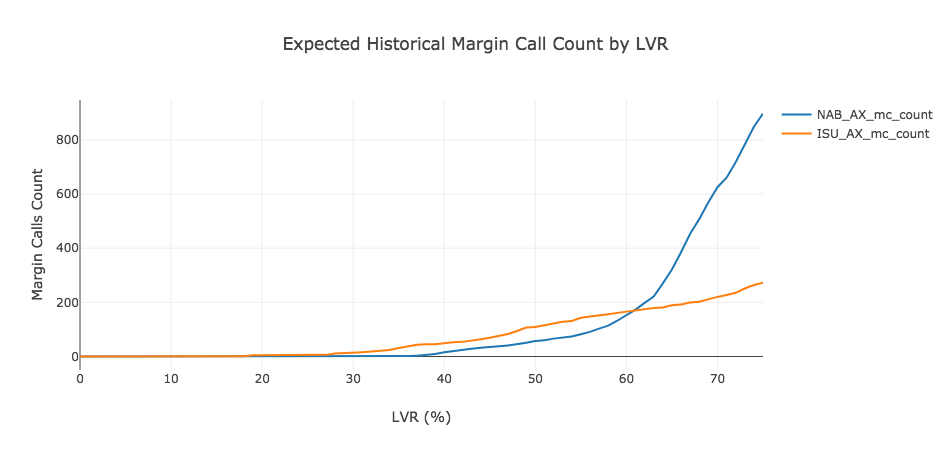

In [112]:
plot_cols = [x for x in df_mc_counts.columns if "count" in x]


fig = pu.timeseries(df_mc_counts, 
                    x = 'lvr',
                    y = plot_cols,
                    xlabel = 'LVR (%)',
                    ylabel = 'Margin Calls Count',
                    title = 'Expected Historical Margin Call Count by LVR'
                   )

iplot(fig)

Clearly something is up with Milton Corp. It's WAYYYY off compared to the rest.

### Join All EOD Data into a Single DF

In [113]:
eod_list = [mc_results[x][0] for x in range(0,len(mc_results))]
eod_df = pd.concat(eod_list, axis=0)

# eod_df.close.replace(0,np.nan, inplace=True)

eod_df.head()

,Date,Open,High,Low,Close,Adj Close,Volume,symbol,market_drawdown
0,2000-01-02,21.870001,21.879499,20.623800,20.823601,6.844578,13213417,NAB.AX,0.000000
1,2000-01-09,21.213600,21.356300,20.290899,20.838800,6.849571,21085347,NAB.AX,0.000000
2,2000-01-16,20.956800,22.250500,20.956800,20.985300,6.897726,12454841,NAB.AX,0.000000
3,2000-01-23,21.213600,21.974600,20.623800,21.080400,6.928984,28522545,NAB.AX,0.000000
4,2000-01-30,20.833099,21.146999,20.443100,20.671400,6.794549,14218039,NAB.AX,-1.940191


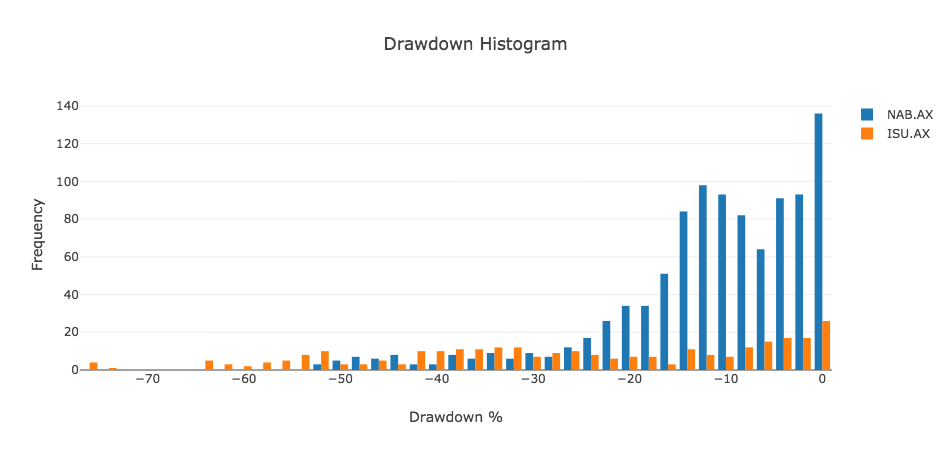

In [114]:
# Drawdown Distributions
# plot_cols = ['ASX:AFI','ASX:ARG','ASX:MLT','ASX:WHF','ASX:XJO','ASX:VTS','ASX:VAS']

fig = pu.histogram(df = eod_df,
                   values='market_drawdown',
                   shape='long',
                   key_col = 'symbol',
#                    keys = 'ASX:MLT',
                   keys = symbols,
                   xlabel = "Drawdown %",
                   ylabel = "Frequency",
                   title = "Drawdown Histogram")
iplot(fig)

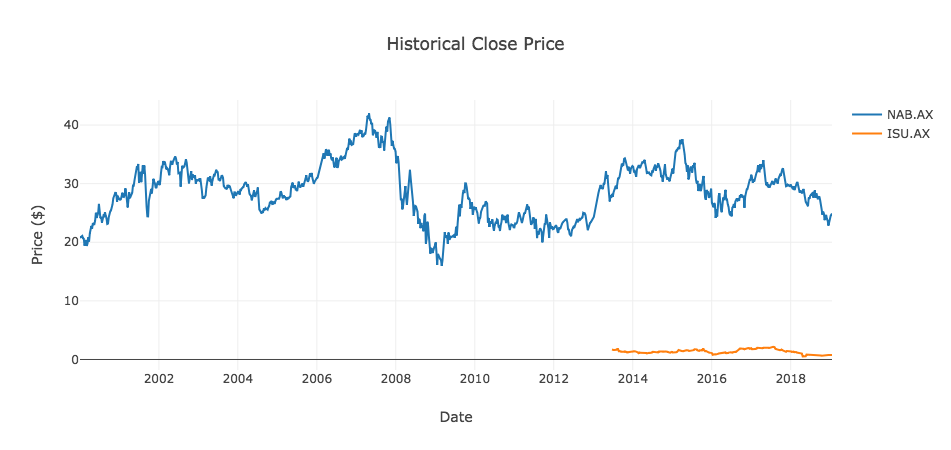

In [116]:
# Time Series
fig = pu.timeseries(df = eod_df,
                    x = 'Date',
                    y = 'Close',
                    title = 'Historical Close Price',
                    xlabel = 'Date',
                    ylabel = 'Price ($)',
                    shape = 'long',
                    key_col = 'symbol',
                    keys = symbols)

iplot(fig)

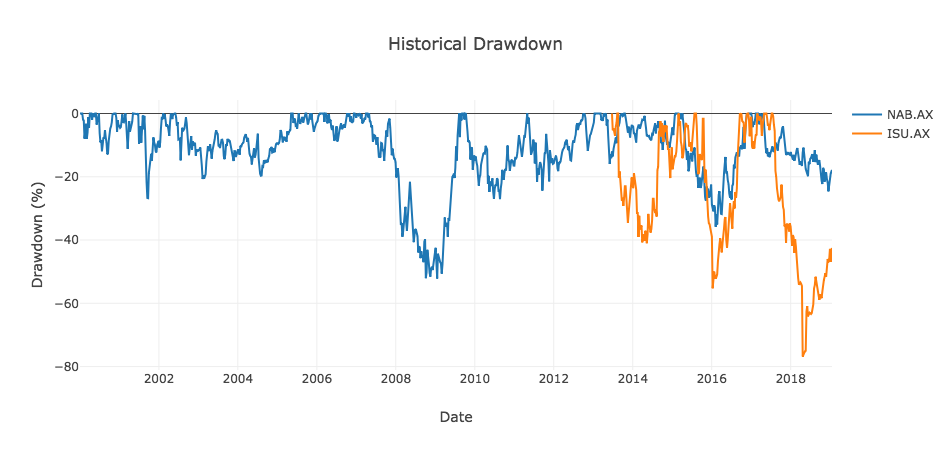

In [267]:
# Drawdown Time Series
fig = pu.timeseries(df = eod_df,
                    x = 'Date',
                    y = 'market_drawdown',
                    title = 'Historical Drawdown',
                    xlabel = 'Date',
                    ylabel = 'Drawdown (%)',
                    shape = 'long',
                    key_col = 'symbol',
                    keys = symbols)

iplot(fig)

# Time Change Distribution

In [372]:
nab_df = eod_df[eod_df.symbol == "NAB.AX"]

nab_df.head()

,Date,Open,High,Low,Close,Adj Close,Volume,symbol,market_drawdown
0,2000-01-02,21.870001,21.879499,20.623800,20.823601,6.844578,13213417,NAB.AX,0.000000
1,2000-01-09,21.213600,21.356300,20.290899,20.838800,6.849571,21085347,NAB.AX,0.000000
2,2000-01-16,20.956800,22.250500,20.956800,20.985300,6.897726,12454841,NAB.AX,0.000000
3,2000-01-23,21.213600,21.974600,20.623800,21.080400,6.928984,28522545,NAB.AX,0.000000
4,2000-01-30,20.833099,21.146999,20.443100,20.671400,6.794549,14218039,NAB.AX,-1.940191


/Users/yassineltahir/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



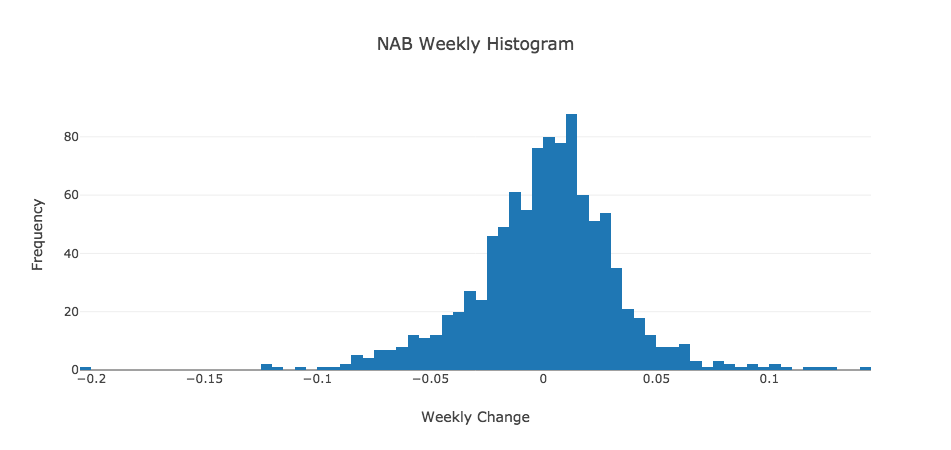

In [373]:
nab_df['change_pct'] = nab_df.Close.diff()/nab_df.Close.shift(1)


# Drawdown Distributions
# plot_cols = ['ASX:AFI','ASX:ARG','ASX:MLT','ASX:WHF','ASX:XJO','ASX:VTS','ASX:VAS']

fig = pu.histogram(df = nab_df, 
                   values='change_pct',
                   xlabel = "Weekly Change",
                   ylabel = "Frequency",
                   title = "NAB Weekly Histogram")
iplot(fig)

In [375]:
ret = nab_df[~nab_df['change_pct'].isna()]['change_pct'].values

mu_norm, sig_norm = norm.fit(ret)
dx = 0.0001  # resolution
x = np.arange(-0.4, 0.4, dx)
pdf = norm.pdf(x, mu_norm, sig_norm)
print("Integral norm.pdf(x; mu_norm, sig_norm) dx = %.2f" % (np.sum(pdf*dx)))
print("Sample mean  = %.5f" % mu_norm)
print("Sample stdev = %.5f" % sig_norm)
print()
 
# Student t best fit (finding: nu)
parm = t.fit(ret)
nu, mu_t, sig_t = parm
pdf2 = t.pdf(x, nu, mu_t, sig_t)
print("Integral t.pdf(x; mu, sig) dx = %.2f" % (np.sum(pdf2*dx)))
print("nu = %.2f" % nu)
print()


# Generate random numbers based on distribution
random_numbers = [t.rvs(nu, mu_t, sig_t) for x in range(0,len(ret))]
# random_numbers = [t.rvs(nu, mu_t, sig_t) for x in range(0,100000)]
random_numbers = pd.Series(random_numbers)

sum_stats_df = pd.DataFrame({
    'actual': pd.Series(ret).describe(),
    'simulated': random_numbers.describe()
})

sum_stats_df

Integral norm.pdf(x; mu_norm, sig_norm) dx = 1.00
Sample mean  = 0.00071
Sample stdev = 0.03240

Integral t.pdf(x; mu, sig) dx = 1.00
nu = 4.12



,actual,simulated
count,994.000000,994.000000
mean,0.000709,0.003238
std,0.032417,0.032997
min,-0.204587,-0.330380
25%,-0.016516,-0.014184
50%,0.002773,0.002766
75%,0.019063,0.021348
max,0.143520,0.217247


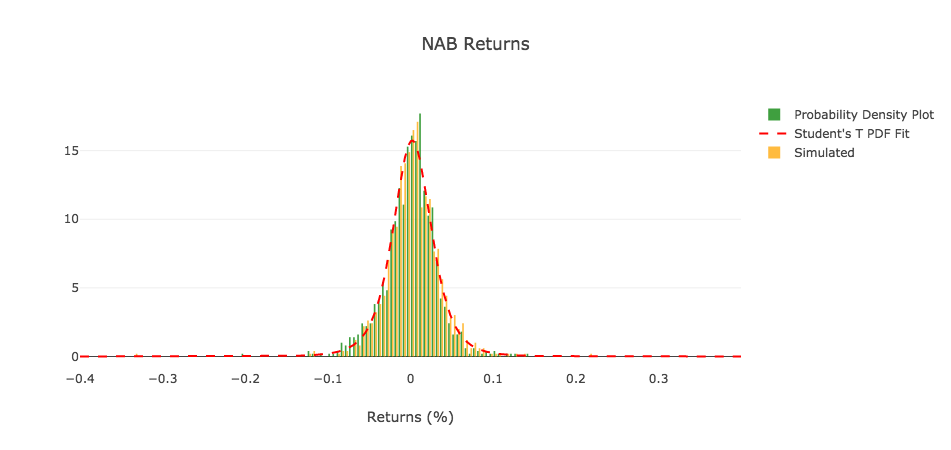

In [376]:
import plotly.graph_objs as go

data = [
    go.Histogram(
        x = ret,
        histnorm="probability density",
        name = "Probability Density Plot",
        marker=dict(
                color='green'
            ),
        opacity=0.75
    ),
    go.Scatter(
            x=x,
            y=pdf2,
            name = "Student's T PDF Fit",
            line = dict(
                dash = 'dash',
                color='red'
            )
        ),
    go.Histogram(
        x = random_numbers,
        histnorm="probability density",
        name = "Simulated",
        marker=dict(
                color='orange'
            ),
        opacity=0.75
    )
]

layout = go.Layout(
        title="NAB Returns",
        yaxis=dict(title=""),
        xaxis=dict(title="Returns (%)")
    )


fig = go.Figure(data=data, layout = layout)

iplot(fig)

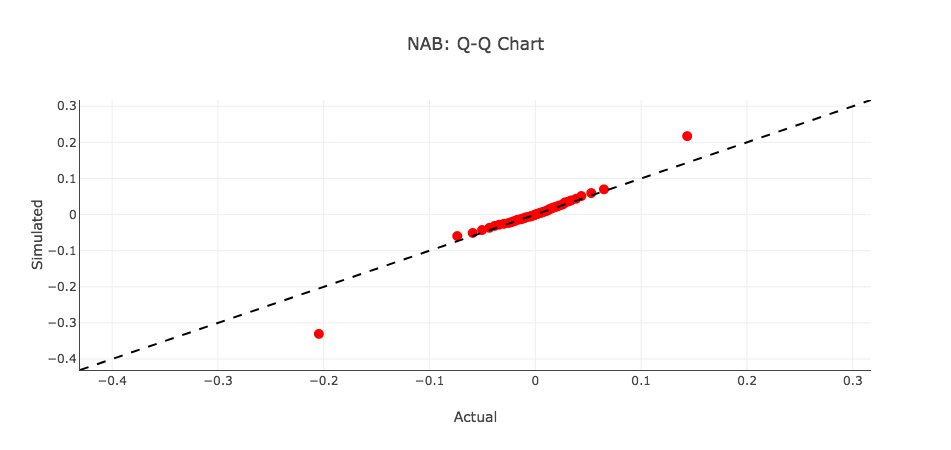

In [377]:
# Calculate quantiles 
percs = np.linspace(0,100,50)
qn_actual = np.percentile(ret, percs)
qn_simulated = np.percentile(random_numbers, percs)

data = [
    go.Trace(
        x = qn_actual,
        y = qn_simulated,
        mode = "markers", 
        marker = dict(
            color = "red",
            size = 10
        )
    )
]

min_tick = min(min(qn_actual), min(qn_simulated)) - 0.1
max_tick = max(max(qn_actual), max(qn_simulated)) + 0.1

lines = [{
        'type': 'line',
        'x0': min_tick,
        'y0': min_tick,
        'x1': max_tick,
        'y1': max_tick,
        'line': {
            'color': 'black',
            'width': 2,
            'dash': 'dash'
        }
    }]



layout = go.Layout(
        title="NAB: Q-Q Chart",
        yaxis=dict(
            title="Simulated",
            showgrid=True,
            zeroline=False,
            showline=True,
            ticks='',
            showticklabels=True,
            range = [min_tick, max_tick]
            ),
        xaxis=dict(
            title="Actual",
            showgrid=True,
            zeroline=False,
            showline=True,
            ticks='',
            showticklabels=True,
            range = [min_tick, max_tick]
        ),
        shapes = lines
    )

# go.Trace()

fig = go.Figure(data=data, layout = layout)

iplot(fig)

# Time Series Decomposition

In [378]:
nab_df.head()

,Date,Open,High,Low,Close,Adj Close,Volume,symbol,market_drawdown,change_pct
0,2000-01-02,21.870001,21.879499,20.623800,20.823601,6.844578,13213417,NAB.AX,0.000000,NaN
1,2000-01-09,21.213600,21.356300,20.290899,20.838800,6.849571,21085347,NAB.AX,0.000000,0.000730
2,2000-01-16,20.956800,22.250500,20.956800,20.985300,6.897726,12454841,NAB.AX,0.000000,0.007030
3,2000-01-23,21.213600,21.974600,20.623800,21.080400,6.928984,28522545,NAB.AX,0.000000,0.004532
4,2000-01-30,20.833099,21.146999,20.443100,20.671400,6.794549,14218039,NAB.AX,-1.940191,-0.019402


In [562]:
nab_df.index = pd.DatetimeIndex(nab_df['Date'])

nab_df = nab_df.asfreq(freq='W',
              method = 'ffill')


[autoreload of yahoo_finance failed: Traceback (most recent call last):
  File "/Users/yassineltahir/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 246, in check
    superreload(m, reload, self.old_objects)
  File "/Users/yassineltahir/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 369, in superreload
    module = reload(module)
  File "/Users/yassineltahir/anaconda3/lib/python3.6/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/Users/yassineltahir/anaconda3/lib/python3.6/importlib/__init__.py", line 166, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 618, in _exec
  File "<frozen importlib._bootstrap_external>", line 674, in exec_module
  File "<frozen importlib._bootstrap_external>", line 781, in get_code
  File "<frozen importlib._bootstrap_external>", line 741, in source_to_code
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_remov

ValueError: cannot reindex a non-unique index with a method or limit

In [461]:
import statsmodels.api as sm

res = sm.tsa.seasonal_decompose(nab_df.Close.interpolate(),
                                model='additive',
                                )

decomp_df = pd.DataFrame({
    'observed': res.observed,
    'trend': res.trend,
    'seasonal': res.seasonal,
    'resid': res.resid
})

In [500]:




decomp_df['recreate'] = decomp_df.trend + decomp_df.seasonal + decomp_df.resid

decomp_df.head(30)

,observed,trend,seasonal,resid,recreate
Date,,,,,
2000-01-02,20.823601,NaN,-0.346745,NaN,NaN
2000-01-09,20.838800,NaN,-0.278793,NaN,NaN
2000-01-16,20.985300,NaN,-0.283305,NaN,NaN
2000-01-23,21.080400,NaN,-0.105946,NaN,NaN
2000-01-30,20.671400,NaN,-0.256101,NaN,NaN
2000-02-06,20.614300,NaN,-0.164418,NaN,NaN
2000-02-13,19.406200,NaN,-0.199116,NaN,NaN
2000-02-20,19.778099,NaN,-0.298791,NaN,NaN
2000-02-27,20.397400,NaN,-0.301292,NaN,NaN


This is the format of your plot grid:
[ (1,1) x1,y1 ]
[ (2,1) x2,y2 ]
[ (3,1) x3,y3 ]
[ (4,1) x4,y4 ]



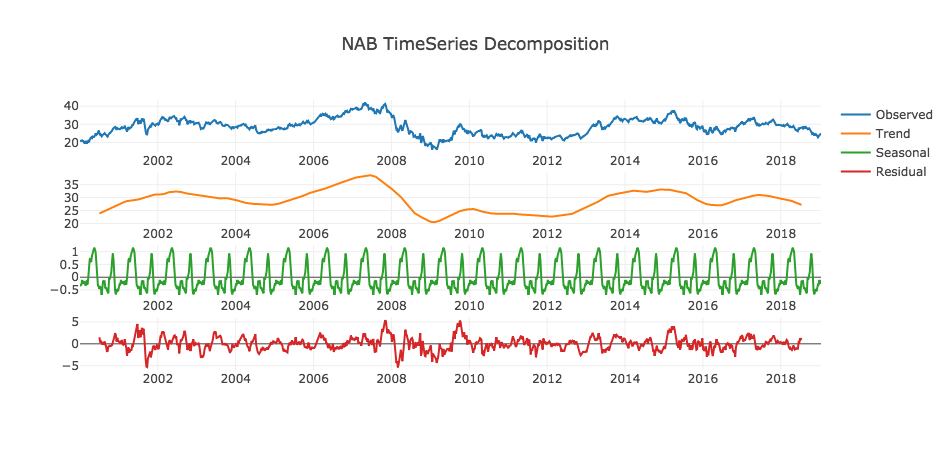

In [490]:
from plotly import tools


trace_observed = go.Scatter(
    y = res.observed.values,
    x = res.observed.index,
    name = 'Observed'
)

trace_trend = go.Scatter(
    y = res.trend.values,
    x = res.trend.index,
    name = 'Trend'
)

trace_seasonal = go.Scatter(
    y = res.seasonal.values,
    x = res.seasonal.index,
    name = 'Seasonal'
)

trace_resid = go.Scatter(
    y = res.resid.values,
    x = res.resid.index,
    name = 'Residual'
)

fig = tools.make_subplots(rows=4, cols=1)

fig.append_trace(trace_observed, 1, 1)
fig.append_trace(trace_trend, 2, 1)
fig.append_trace(trace_seasonal, 3, 1)
fig.append_trace(trace_resid, 4, 1)


fig['layout'].update(title='NAB TimeSeries Decomposition')

iplot(fig)


### Plotly Updates
1. Get rid of stupid "This is the format..." nonsense
2. Add dividend paydaates to seasonal chart (or a separate chart)
3. Add access labels

### Residuals Distribution Fitting

In [ ]:
def residuals_distribution(residuals, resolution = 0.0001):
    
    # Extract distribution properties
    mu, sig = norm.fit(resids)
    
    # Build a representative range
    x_range = np.arange(min(residuals), max(residuals), resolution)
    
    # Build fitted distribution
    pdf = norm.pdf(x_range, mu_norm, sig_norm)
    
    # Generate distribution based on 
    
    
    

In [ ]:
resids = decomp_df[~decomp_df['resid'].isna()]['resid']

mu_norm, sig_norm = norm.fit(resids)
dx = 0.0001  # resolution
x = np.arange(min(resids), max(resids), dx)
pdf = norm.pdf(x, mu_norm, sig_norm)
print("Integral norm.pdf(x; mu_norm, sig_norm) dx = %.2f" % (np.sum(pdf*dx)))
print("Sample mean  = %.5f" % mu_norm)
print("Sample stdev = %.5f" % sig_norm)
print()

# Generate random numbers based on distribution
random_numbers = [norm.rvs(mu_norm, sig_norm) for x in range(0,len(resids))]
random_numbers = pd.Series(random_numbers)

sum_stats_df = pd.DataFrame({
    'actual': pd.Series(ret).describe(),
    'simulated': random_numbers.describe()
})

sum_stats_df

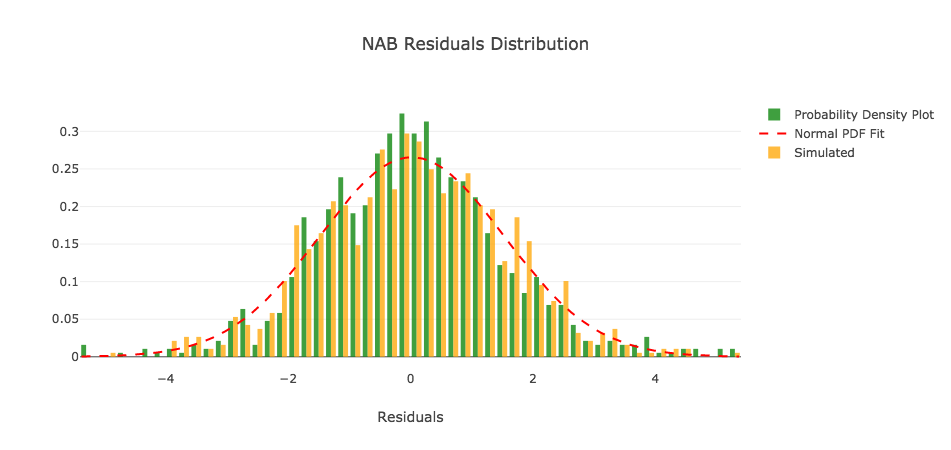

In [530]:
import plotly.graph_objs as go

data = [
    go.Histogram(
        x = resids,
        histnorm="probability density",
        name = "Probability Density Plot",
        marker=dict(
                color='green'
            ),
        opacity=0.75
    ),
    go.Scatter(
            x=x,
            y=pdf,
            name = "Normal PDF Fit",
            line = dict(
                dash = 'dash',
                color='red'
            )
        ),
    go.Histogram(
        x = random_numbers,
        histnorm="probability density",
        name = "Simulated",
        marker=dict(
                color='orange'
            ),
        opacity=0.75
    )
]

layout = go.Layout(
        title="NAB Residuals Distribution",
        yaxis=dict(title=""),
        xaxis=dict(title="Residuals")
    )


fig = go.Figure(data=data, layout = layout)

iplot(fig)



From above, assuming residuals are normmally distributed we can use this to generate new noise & use that recompose the timeseries

In [576]:
num_simulations = 50
required_samples = decomp_df.shape[0]

for sim in range(0, num_simulations):
    col_name = "simulation_{}".format(sim)
    decomp_df[col_name] = decomp_df.apply(lambda x: x['trend'] + x['seasonal'] + norm.rvs(mu_norm, sig_norm), axis=1)
    

decomp_df['Date'] = decomp_df.index
# decomp_df.head(100)

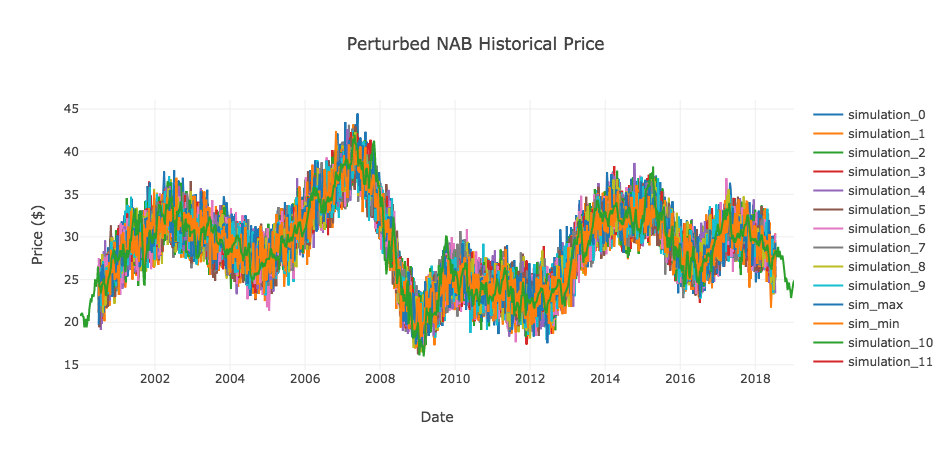

In [577]:
plot_cols = [x for x in decomp_df.columns if 'sim' in x]
plot_cols.append('observed')

fig = pu.timeseries(df = decomp_df,
                    x ='Date',
                    y = plot_cols,
                    title = "Perturbed NAB Historical Price",
                    xlabel = 'Date',
                    ylabel = 'Price ($)')

iplot(fig)

In [578]:
decomp_df['sim_max'] = decomp_df[[x for x in decomp_df.columns if 'sim' in x]].max(axis=1)
decomp_df['sim_min'] = decomp_df[[x for x in decomp_df.columns if 'sim' in x]].min(axis=1)

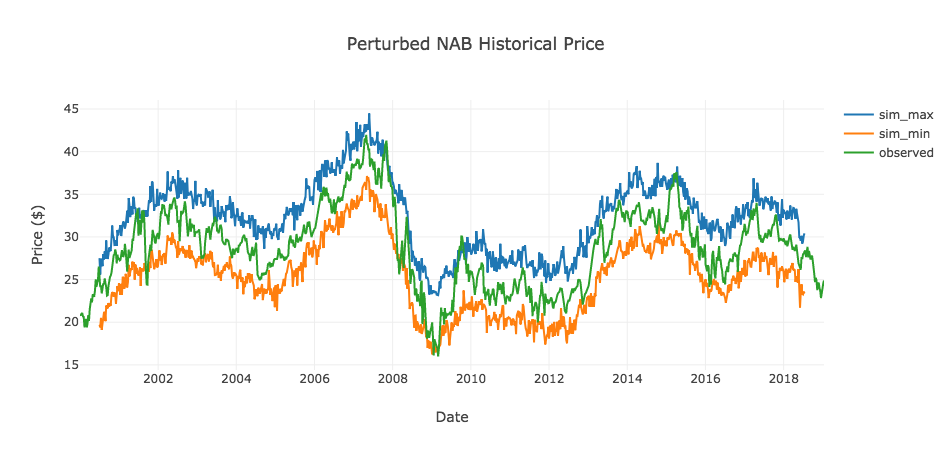

In [579]:
plot_cols = ['sim_max', 'sim_min', 'observed']

fig = pu.timeseries(df = decomp_df,
                    x ='Date',
                    y = plot_cols,
                    title = "Perturbed NAB Historical Price",
                    xlabel = 'Date',
                    ylabel = 'Price ($)')

iplot(fig)

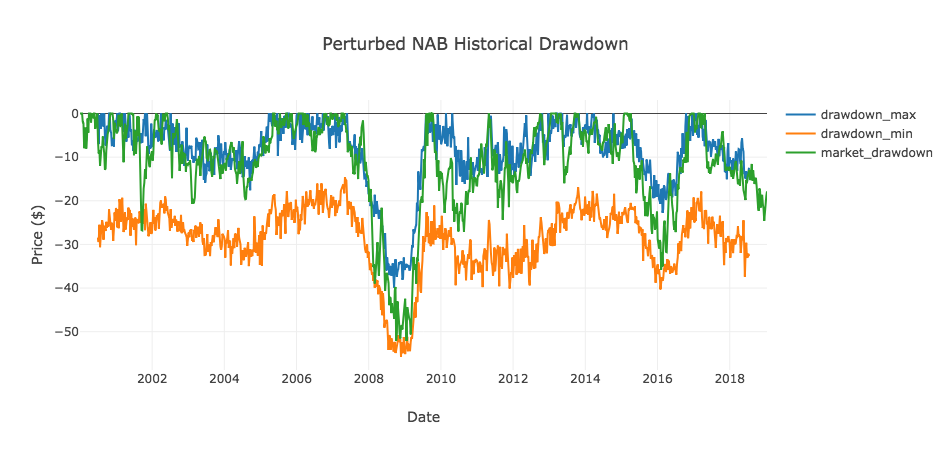

In [590]:
# Get Actual Drawdown
decomp_df = hlp.calc_drawdown(decomp_df, 'observed', 52)

# Calculate rolling prior maximum to compare against current price
prior_max = decomp_df[plot_cols].rolling(window=52, min_periods=1).max().max(axis=1)

# Calculate percentage change, aka drawdown
decomp_df['drawdown_max'] = (decomp_df['sim_max']/prior_max - 1.0) * 100
decomp_df['drawdown_min'] = (decomp_df['sim_min']/prior_max - 1.0) * 100


drawdown_cols = ['drawdown_max', 'drawdown_min', 'market_drawdown']

fig = pu.timeseries(df = decomp_df,
                    x ='Date',
                    y = drawdown_cols,
                    title = "Perturbed NAB Historical Drawdown",
                    xlabel = 'Date',
                    ylabel = 'Price ($)')

iplot(fig)

In [604]:
print("Simulated Safe LVR's")
for col in drawdown_cols:
    
    max_safe_lvr = hlp.calc_max_safe_lvr(decomp_df[col].min(), 0.75)
    
    print("{}: {:.2f}%".format(col, max_safe_lvr))

Simulated Safe LVR's
drawdown_max: 45.11%
drawdown_min: 33.24%
market_drawdown: 35.89%
